<a href="https://colab.research.google.com/github/jenports/climate-analysis/blob/main/Adaptive_Comfort_Modelling.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

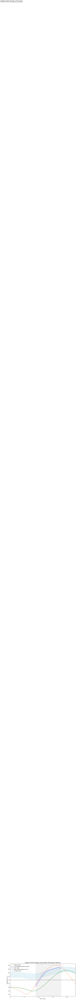

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# Temperature data for 24h (Southampton, 30 July 2024)
outdoor_24h = np.array([
    18.0, 17.5, 17.0, 16.5, 15.5, 14.5, 14.0, 15.0, 17.0, 19.5, 22.0, 24.5,
    26.5, 28.0, 29.0, 30.0, 30.0, 30.0, 29.5, 28.0, 26.0, 24.0, 22.0, 20.0
])
hours = np.arange(24)

# Compute T_rm (exponentially weighted mean)
a = 0.8
T_rm = np.zeros(24)
T_rm[0] = outdoor_24h[0]
for i in range(1, 24):
    T_rm[i] = (1 - a) * outdoor_24h[i - 1] + a * T_rm[i - 1]

# Default comfort band (based on historic average of 12°C)
T_comf_start = 0.33 * 12 + 18.8
band_width = 3.0
comfort_min_start = np.full(24, T_comf_start - band_width / 2)
comfort_max_start = np.full(24, T_comf_start + band_width / 2)

# Adaptive comfort band
T_comf_adaptive = 0.33 * T_rm + 18.8
comfort_min_adaptive = T_comf_adaptive - band_width / 2
comfort_max_adaptive = T_comf_adaptive + band_width / 2

# HVAC logic (during occupancy hours, upper adaptive limit or 1°C below outdoor temp)
occupied = (hours >= 9) & (hours <= 18)
fixed_setpoint = 22.0
hvac_temp = np.where(
    occupied,
    np.minimum(comfort_max_adaptive, outdoor_24h - 1.0),
    np.nan
)

# Create figure and axis
fig, ax = plt.subplots(figsize=(12, 6))
line_out, = ax.plot([], [], label='Outdoor Temp', color='orangered', linestyle='--')
line_trm, = ax.plot([], [], label='T_rm (Weighted Outdoor Mean)', color='green')
line_hvac, = ax.plot([], [], label='HVAC Temp', color='blue')
ax.plot(hours, [fixed_setpoint]*24, 'k--', label='Fixed Comfort Setpoint (22°C)')
ax.axvspan(9, 18, color='grey', alpha=0.1, label='Occupied Hours')

# Set plot limits
ax.set_xlim(0, 23)
ax.set_ylim(13, 31)
ax.set_xlabel('Hour of Day')
ax.set_ylabel('Temperature (°C)')
ax.set_title('Adaptive HVAC Strategy Using Outdoor Temperature Memory')
ax.legend()

# Initial comfort band fill (will be replaced in the first frame of the update function)
comfort_fill = None # Initialize to None

# Text overlay
text_overlay = ax.text(0.5, 30.5, '', fontsize=12, ha='center', va='bottom', color='black',
                       bbox=dict(facecolor='white', alpha=0.7), transform=ax.get_xaxis_transform())

# Animation function
def update(frame):
    global comfort_fill  # Declare comfort_fill as global to modify it

    # Remove the previous fill_between collection if it exists
    if comfort_fill is not None:
        comfort_fill.remove()

    if frame < 50:
        # Phase 1: Static band
        fill_min = comfort_min_start
        fill_max = comfort_max_start
        text_overlay.set_text("Initial comfort band\nbased on UK average temperature (12°C)")
        line_out.set_data([], []) # Clear data if not yet plotting
        line_trm.set_data([], [])
        line_hvac.set_data([], [])

    elif 50 <= frame < 74:
        # Phase 2: Build outdoor temperature
        idx = frame - 50 + 1
        line_out.set_data(hours[:idx], outdoor_24h[:idx])
        fill_min = comfort_min_start
        fill_max = comfort_max_start
        text_overlay.set_text("Outdoor temperature profile develops")
        line_trm.set_data([], []) # Clear T_rm if not yet plotting
        line_hvac.set_data([], [])


    elif 74 <= frame < 98:
        # Phase 3: Add T_rm
        line_out.set_data(hours, outdoor_24h)
        idx = frame - 74 + 1
        line_trm.set_data(hours[:idx], T_rm[:idx])
        fill_min = comfort_min_start
        fill_max = comfort_max_start
        text_overlay.set_text("T_rm reflects thermal memory of past days")
        line_hvac.set_data([], []) # Clear HVAC if not yet plotting


    elif 98 <= frame < 148:
        # Phase 4: Transition comfort band upward
        line_out.set_data(hours, outdoor_24h)
        line_trm.set_data(hours, T_rm)
        alpha = (frame - 98) / 50
        fill_min = (1 - alpha) * comfort_min_start + alpha * comfort_min_adaptive
        fill_max = (1 - alpha) * comfort_max_start + alpha * comfort_max_adaptive
        text_overlay.set_text("Comfort band shifts upward\nas occupants adapt to warmer weather")
        line_hvac.set_data([], []) # Clear HVAC if not yet plotting


    elif 148 <= frame < 172:
        # Phase 5: Reveal HVAC gradually
        line_out.set_data(hours, outdoor_24h)
        line_trm.set_data(hours, T_rm)
        idx = frame - 148 + 1
        line_hvac.set_data(hours[:idx], hvac_temp[:idx])
        fill_min = comfort_min_adaptive
        fill_max = comfort_max_adaptive
        text_overlay.set_text("HVAC adapts to minimise energy use\nwhile maintaining comfort")


    else:
        # Final state
        line_out.set_data(hours, outdoor_24h)
        line_trm.set_data(hours, T_rm)
        line_hvac.set_data(hours, hvac_temp)
        fill_min = comfort_min_adaptive
        fill_max = comfort_max_adaptive
        text_overlay.set_text("Adaptive HVAC strategy in final state")

    # Create the new fill_between collection for the current frame
    comfort_fill = ax.fill_between(hours, fill_min, fill_max, color='lightblue', alpha=0.3)

    # Return artists that need redrawing (optional but good practice for blitting)
    # Add the text_overlay to the returned artists as it's updated
    return line_out, line_trm, line_hvac, comfort_fill, text_overlay


# Create animation
ani = animation.FuncAnimation(fig, update, frames=200, interval=100, blit=True) # Enable blitting

# Display in Google Colab or Jupyter
from IPython.display import HTML
HTML(ani.to_jshtml())